<a href="https://colab.research.google.com/github/kalinkabel/Vis-o_Computacional/blob/main/Mask_R_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/alsombra/Mask_RCNN-TF2/ # repositório atualizado


In [ ]:
%pwd

In [ ]:
%cd Mask_RCNN-TF2/

In [ ]:
%pwd

In [ ]:
!pip install -r requirements.txt

In [ ]:
!python setup.py install

In [ ]:
%cd ..

**Importação das Bibliotecas**

In [11]:
import os
import sys
import random
import math
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage.io
from skimage.io import imread
from google.colab.patches import cv2_imshow


In [12]:
import tensorflow as tf
tf.__version__

'2.12.0'

In [13]:
ROOT_DIR = os.path.abspath('./Mask_RCNN-TF2/')
ROOT_DIR

'/content/Mask_RCNN-TF2'

In [ ]:
sys.path

In [ ]:
sys.path.append(ROOT_DIR)
sys.path

In [16]:
from mrcnn import utils
from mrcnn import visualize
import mrcnn.model as modellib

In [ ]:
sys.path.append(os.path.join(ROOT_DIR, 'samples/coco/'))
sys.path

In [18]:
import coco

In [19]:
MODEL_DIR = os.path.join(ROOT_DIR, 'logs')
IMAGE_DIR = os.path.join(ROOT_DIR, 'images')

In [20]:
print(MODEL_DIR, IMAGE_DIR)

/content/Mask_RCNN-TF2/logs /content/Mask_RCNN-TF2/images


**Carregamento da Rede Neural Pré Treinada**

In [21]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

In [22]:
COCO_MODEL_PATH = os.path.join(ROOT_DIR, 'mask_rcnn_coco.h5')

In [23]:
COCO_MODEL_PATH

'/content/Mask_RCNN-TF2/mask_rcnn_coco.h5'

In [ ]:
if not os.path.exists(COCO_MODEL_PATH):
  utils.download_trained_weights(COCO_MODEL_PATH)

**Configuração Ineferência**

In [25]:
class InferenceConfig(coco.CocoConfig):
  GPU_COUNT = 1
  IMAGES_PER_GPU = 1
config = InferenceConfig()

In [26]:
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                93
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

# **Criação dos Modelos e Carregamento dos Pesos**

In [27]:
MODEL_DIR

'/content/Mask_RCNN-TF2/logs'

In [ ]:
model = modellib.MaskRCNN(mode='inference', config=config, model_dir=MODEL_DIR)

In [29]:
model.load_weights(COCO_MODEL_PATH, by_name=True)

**Definição dos Nomes das classes**

In [30]:
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

In [31]:
len(class_names)

81

In [32]:
class_names[5]

'airplane'

In [33]:
class_names.index('airplane')

5

# **Predição e Visualização**

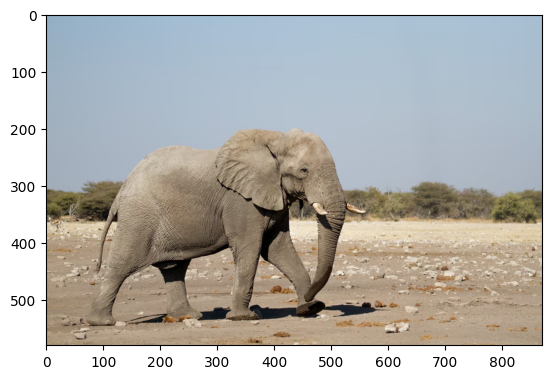

In [34]:
img = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/elefante.jpg')
plt.imshow(img);

**Criando a Segmentação**

In [ ]:
resultados = model.detect([img], verbose = 0)

In [36]:
resultados

[{'rois': array([[201,  71, 548, 564]], dtype=int32),
  'class_ids': array([21], dtype=int32),
  'scores': array([0.999958], dtype=float32),
  'masks': array([[[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]],
  
         [[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]],
  
         [[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]],
  
         ...,
  
         [[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]],
  
         [[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]],
  
         [[False],
          [False],
          [False],
          ...,
          [False],
          [False],
          [False]]])}]

In [37]:
r = resultados[0]


In [38]:
print(r['class_ids'])

[21]


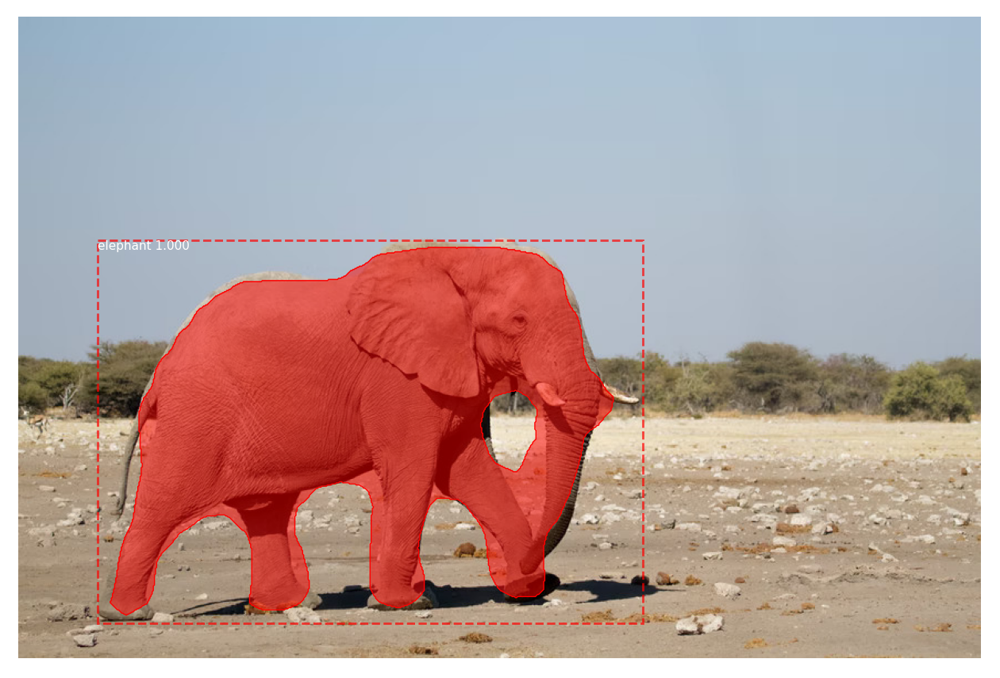

In [39]:
visualize.display_instances(img, r['rois'], r['masks'], r['class_ids'], class_names, r['scores'])

In [40]:
print('Segmentos detectados: ', str(len(r['scores'])))

Segmentos detectados:  1


In [41]:
r['scores']

array([0.999958], dtype=float32)

In [42]:
img1 = imread('/content/Mask_RCNN-TF2/images/2516944023_d00345997d_z.jpg')

In [43]:
def mostrar(imagem):
  fig = plt.gcf()
  fig.set_size_inches(18,8)
  plt.imshow(imagem, cmap='gray')
  plt.axis('off')
  plt.show()

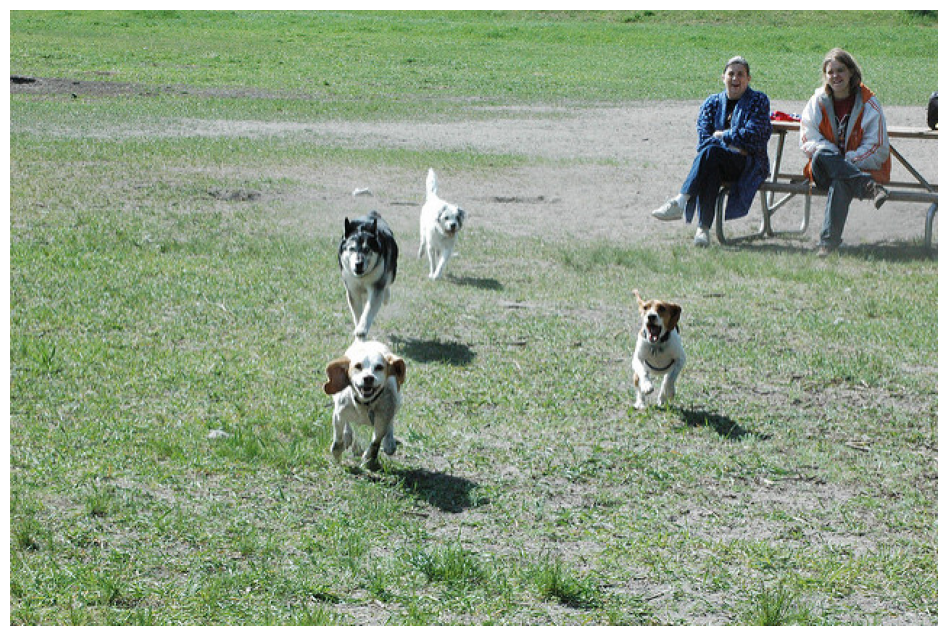

In [44]:
mostrar(img1)

In [45]:
def segmentar_imagem(img):
  resultados = model.detect([img], verbose = 0)
  r = resultados[0]
  visualize.display_instances(img, r['rois'], r['masks'], r['class_ids'], class_names, r['scores'])
  print('Segmentos detectados: ', len(r['scores']))
  return r

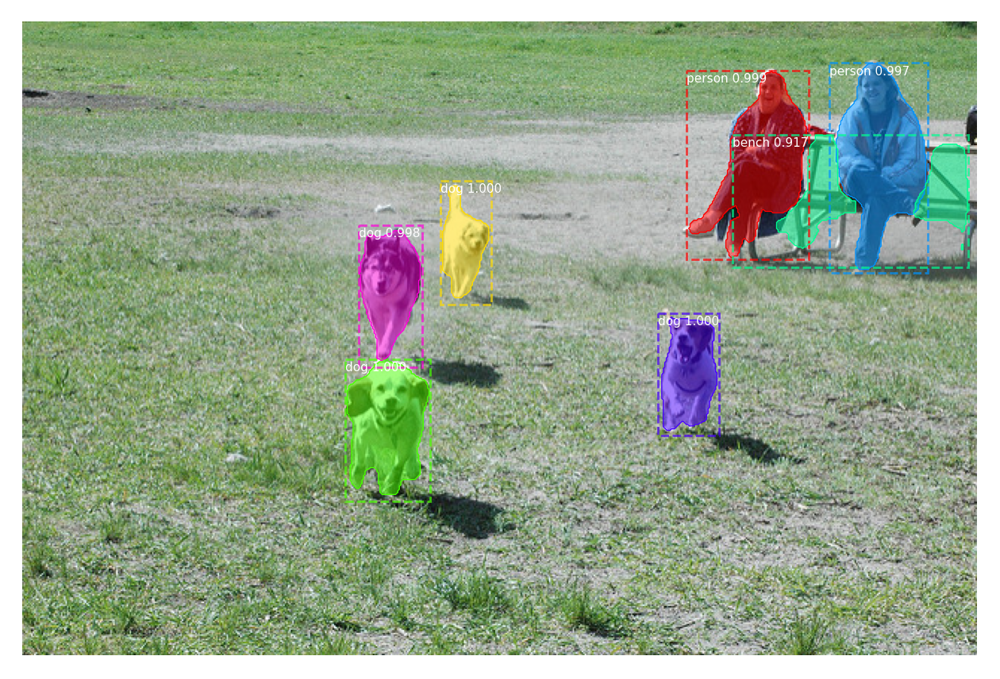

Segmentos detectados:  7


In [46]:
r = segmentar_imagem(img1)

In [47]:
r['class_ids']

array([17, 17, 17,  1, 17,  1, 14], dtype=int32)

In [48]:
class_names[17], class_names[1], class_names[14]

('dog', 'person', 'bench')

In [53]:
r['masks'].shape

(425, 640, 7)

# Remoção do fundo

In [54]:
def segmentar(img, r, idx):
  mask =r['masks'][:,:,idx]
  mask = np.stack((mask,)*3, axis = -1)
  mask = mask.astype('uint8')
  bg = 255 - mask * 255
  mask_exibir = np.invert(bg)
  mask_img = img * mask
  res = mask_img + bg
  return res, mask_exibir

In [55]:
segmentacao, mask_obj = segmentar(img1, r, 4)

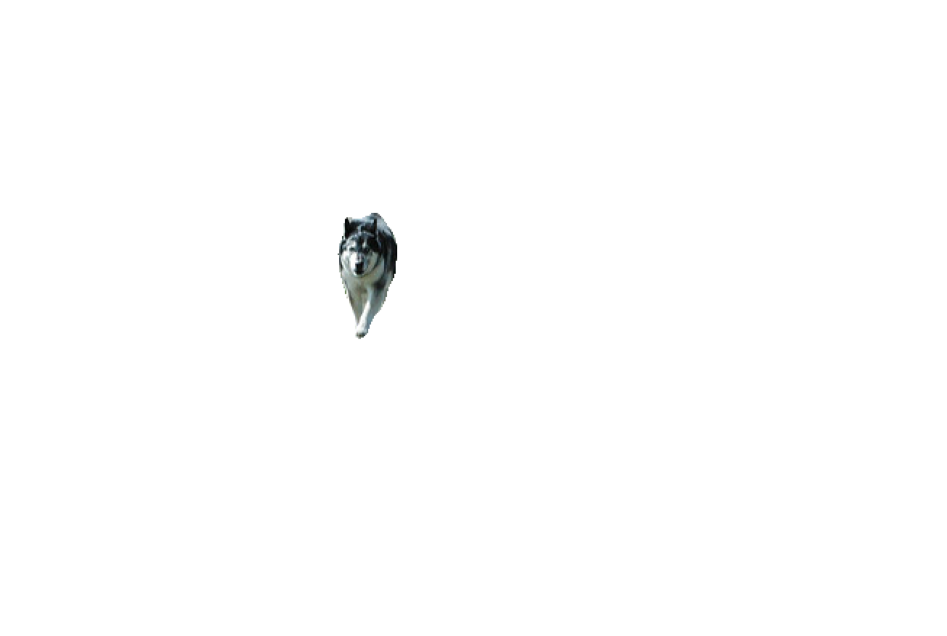

In [56]:
mostrar(segmentacao)

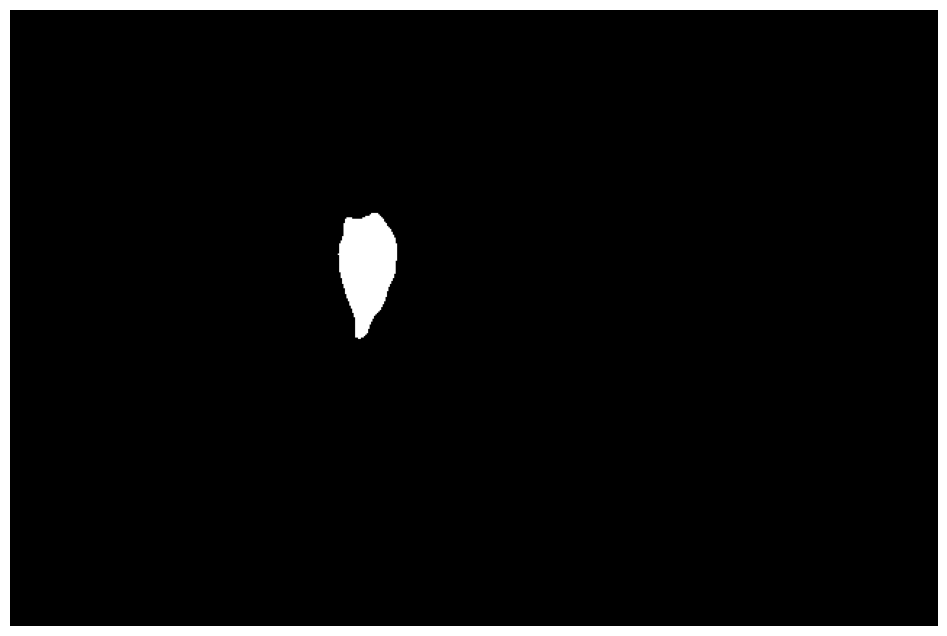

In [57]:
mostrar(mask_obj)

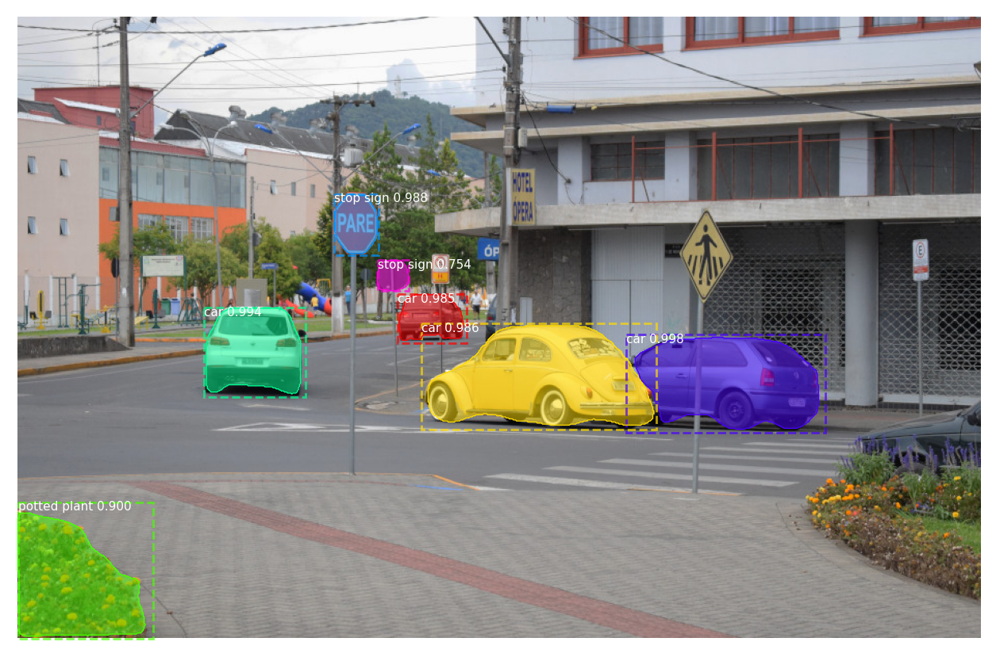

Segmentos detectados:  7


In [58]:
img2 = imread("/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana01.jpg")
r = segmentar_imagem(img2)

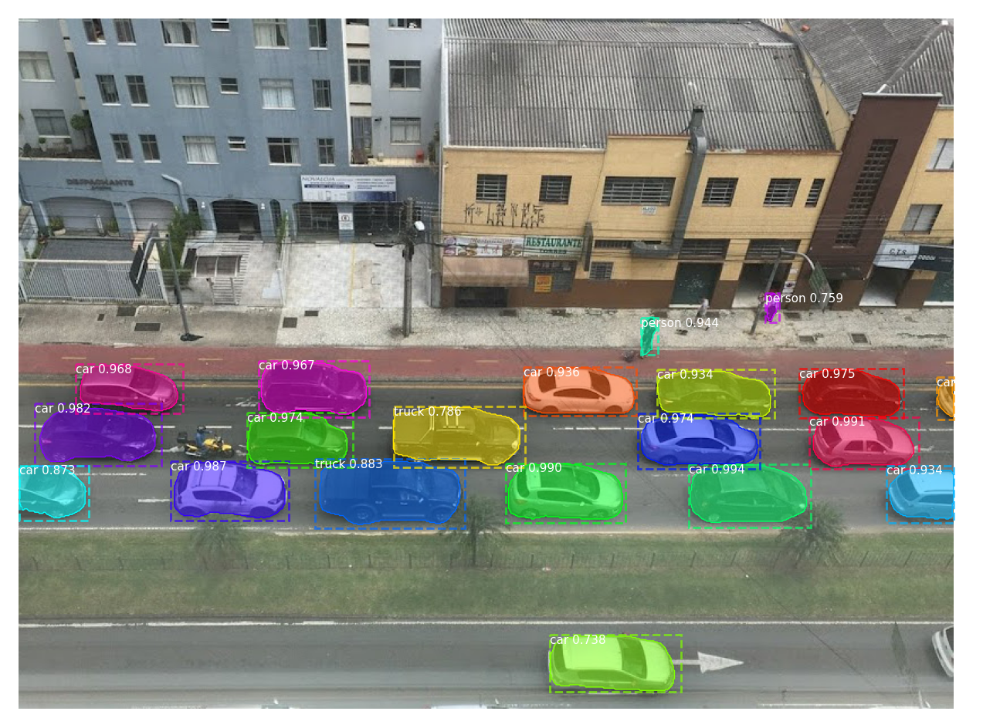

Segmentos detectados:  20


In [60]:
img3 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana02.jpg')
r =segmentar_imagem(img3)

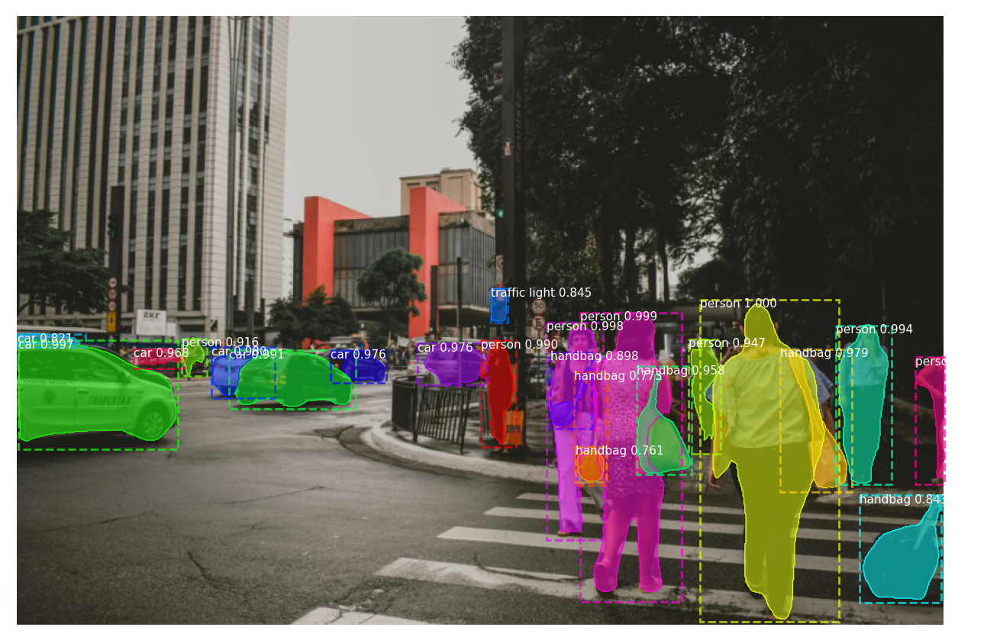

Segmentos detectados:  22


In [61]:
img4 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres01.jpg')
r = segmentar_imagem(img4)

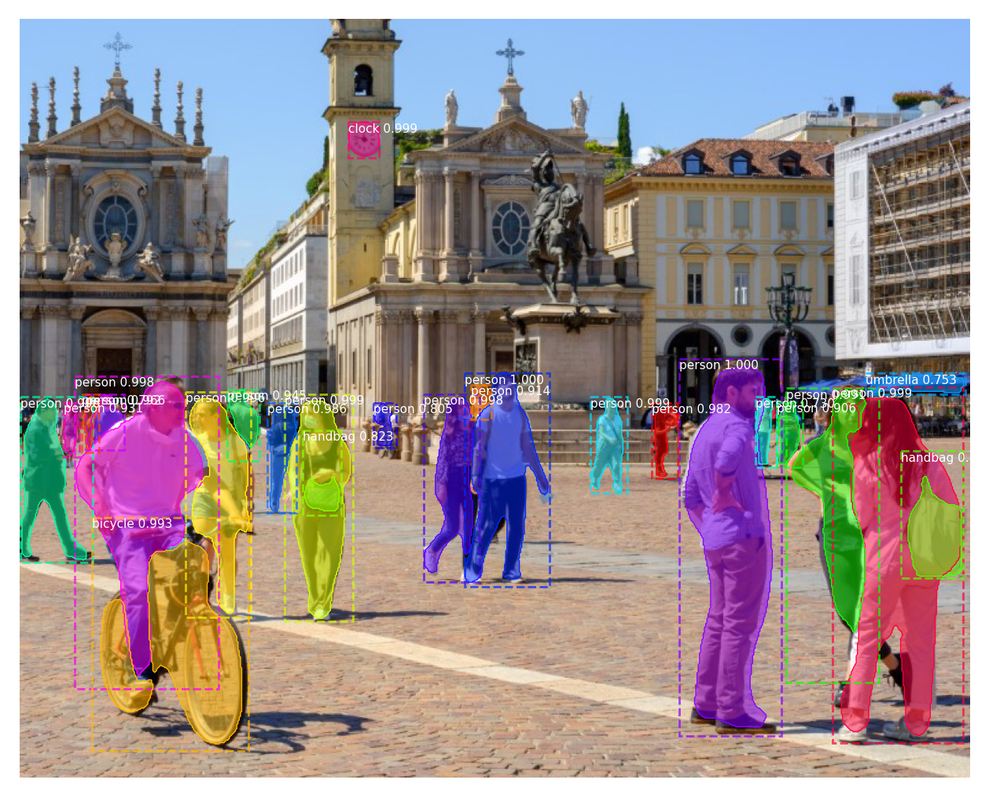

Segmentos detectados:  25


In [62]:
img5 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres02.jpg')
r = segmentar_imagem(img5)

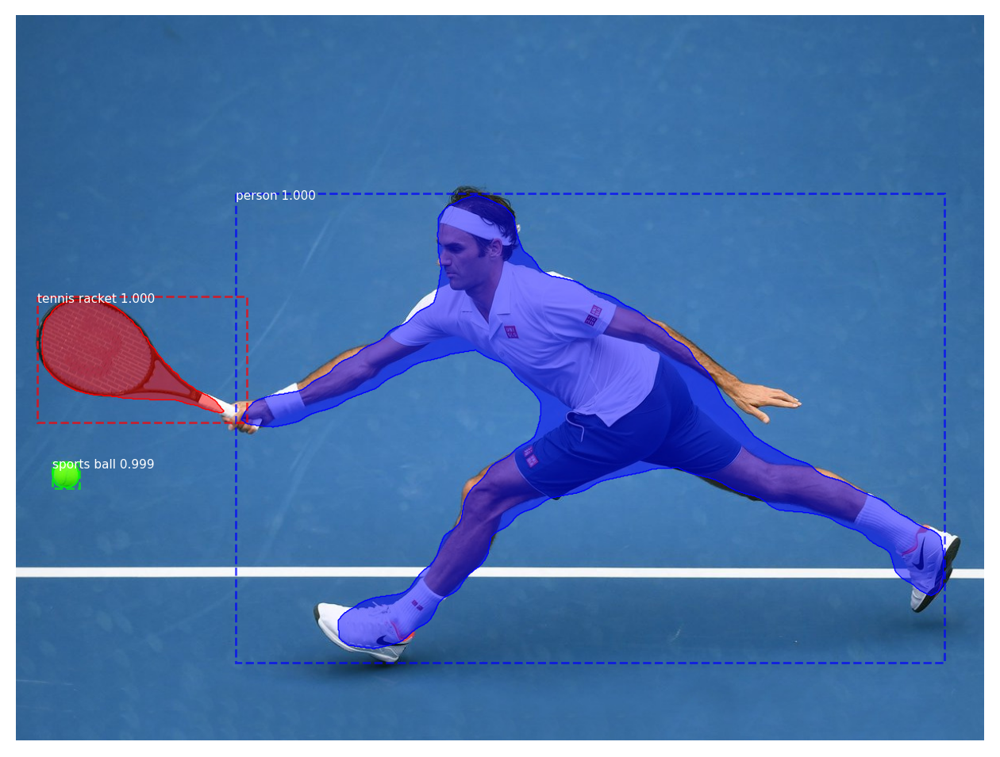

Segmentos detectados:  3


In [63]:
img6 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/tenis01.jpg')
r = segmentar_imagem(img6)

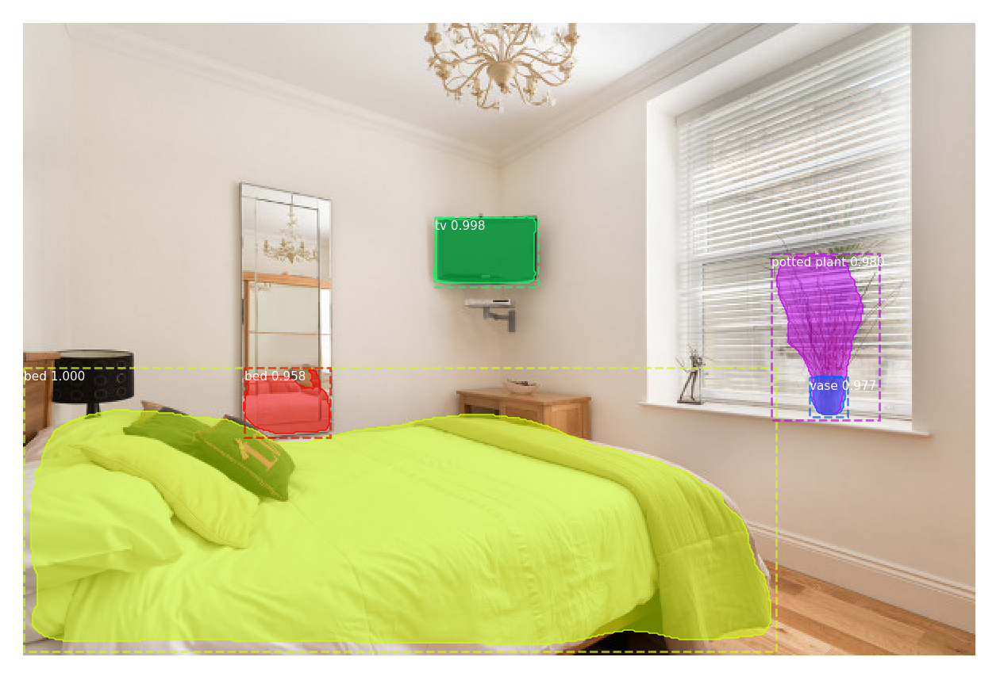

Segmentos detectados:  5


In [64]:
img7 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/quarto.jpg')
r = segmentar_imagem(img7)

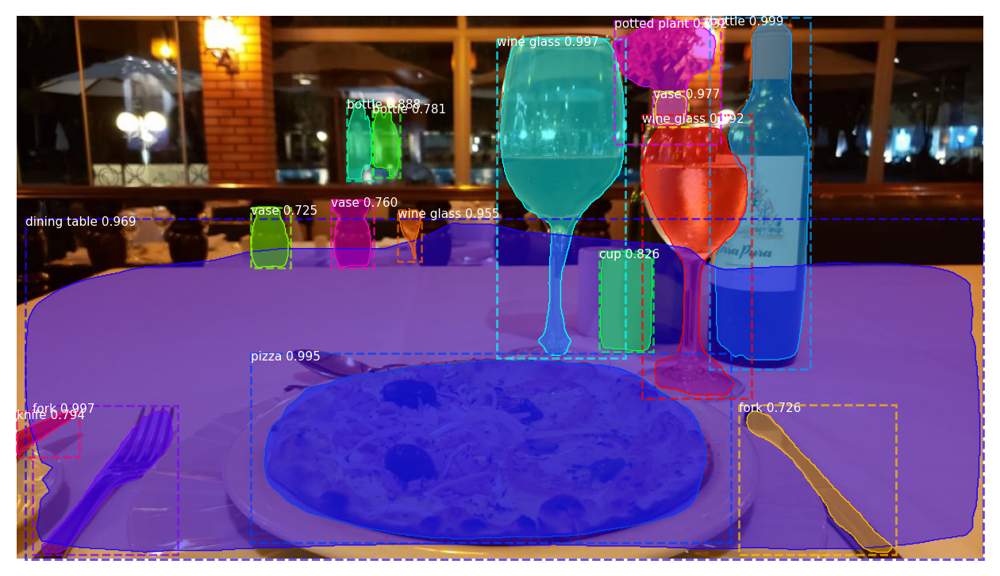

Segmentos detectados:  16


In [66]:
img8 = imread('/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/jantar.jpg')
r = segmentar_imagem(img8)

In [68]:
dir_fotos = "/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos"
caminhos = [os.path.join(dir_fotos, f) for f in os.listdir(dir_fotos)]

In [69]:
caminhos, len(caminhos)

(['/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres01.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/motocross.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/elefante.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana02.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana01.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana03.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres03.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres02.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/quarto.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/jantar.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/futebol01.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/garota-e-cachorro.jpg',
  '/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/tenis02.jpg',
  '/cont

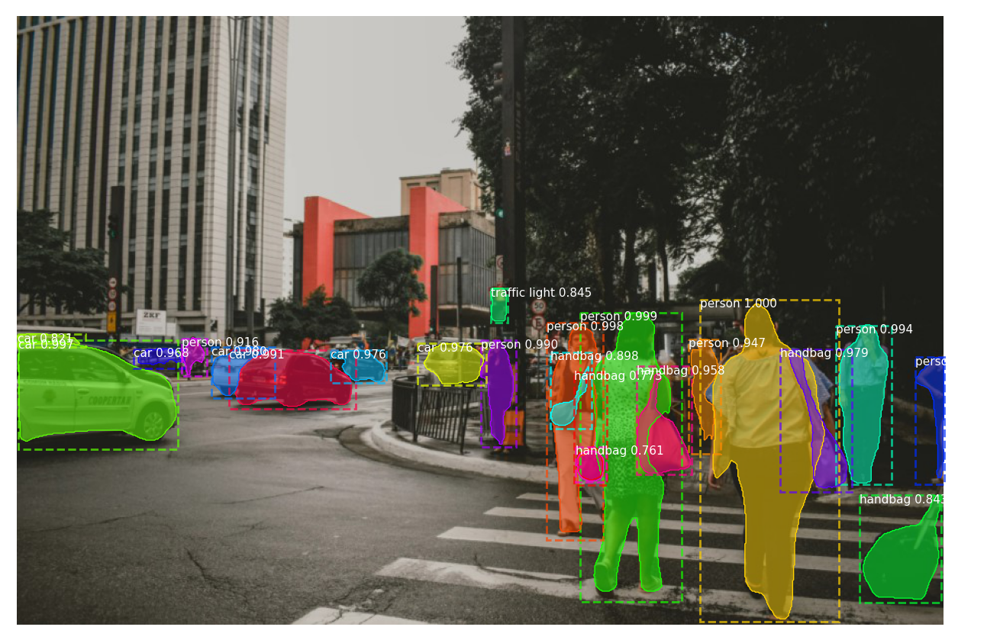

Segmentos detectados:  22


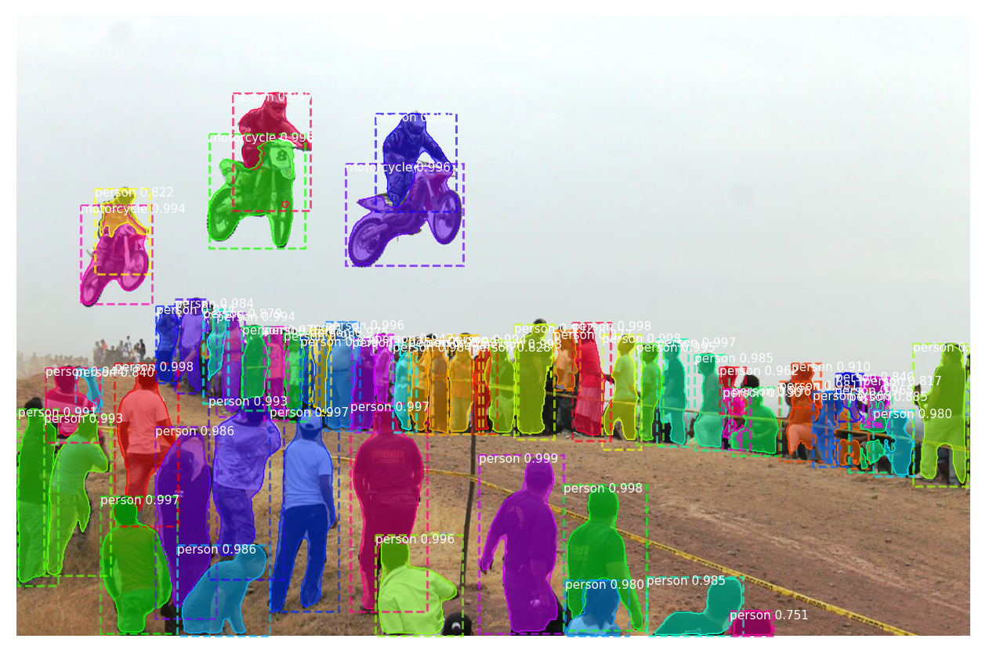

Segmentos detectados:  60


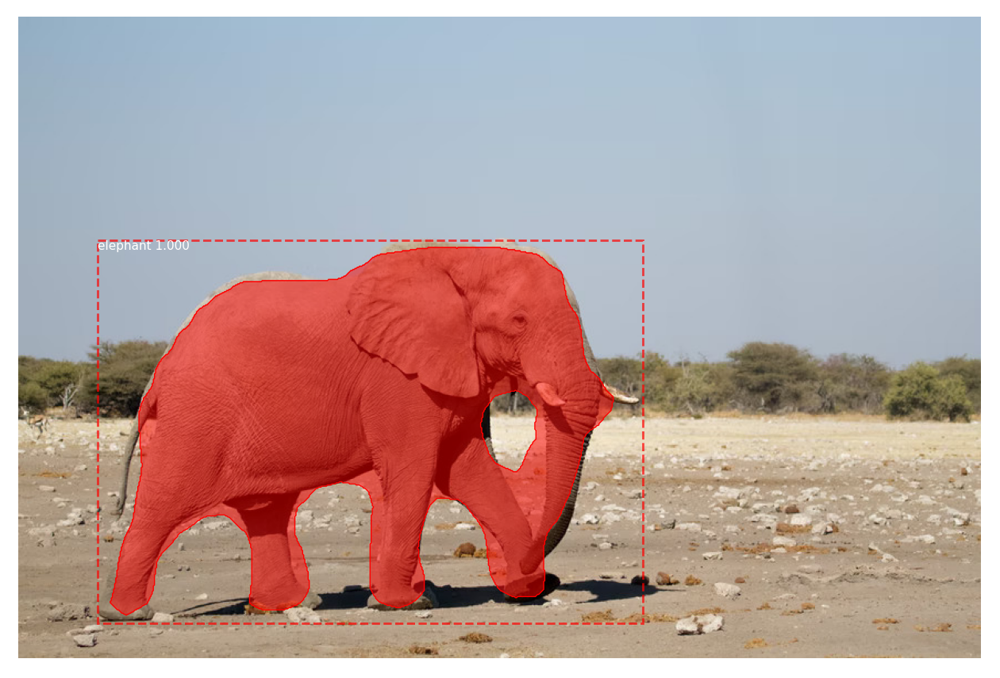

Segmentos detectados:  1


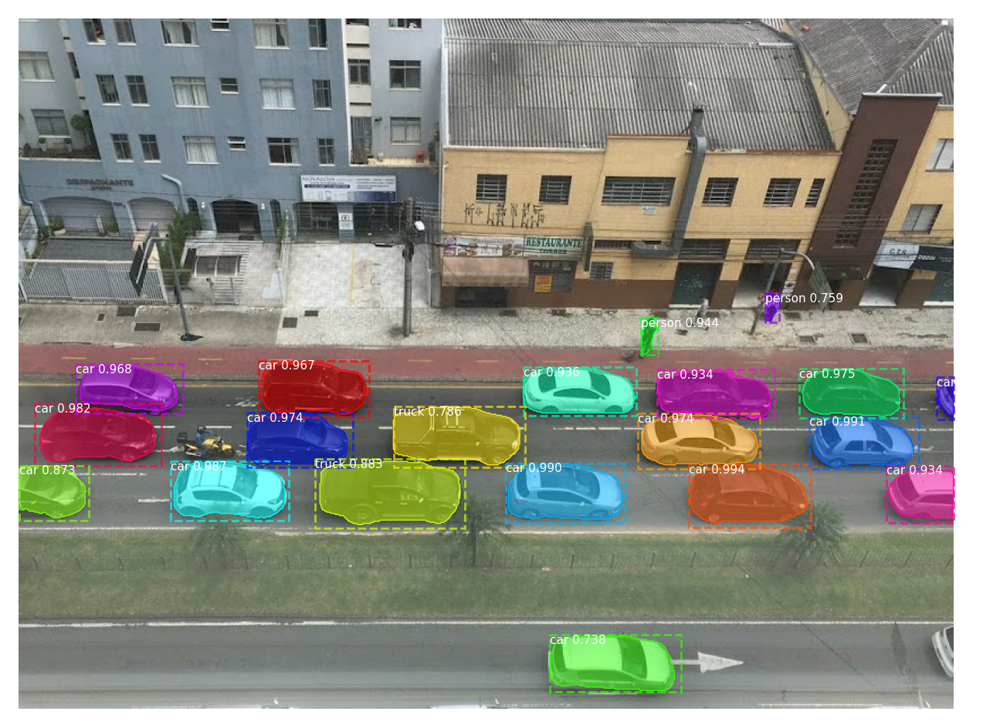

Segmentos detectados:  20


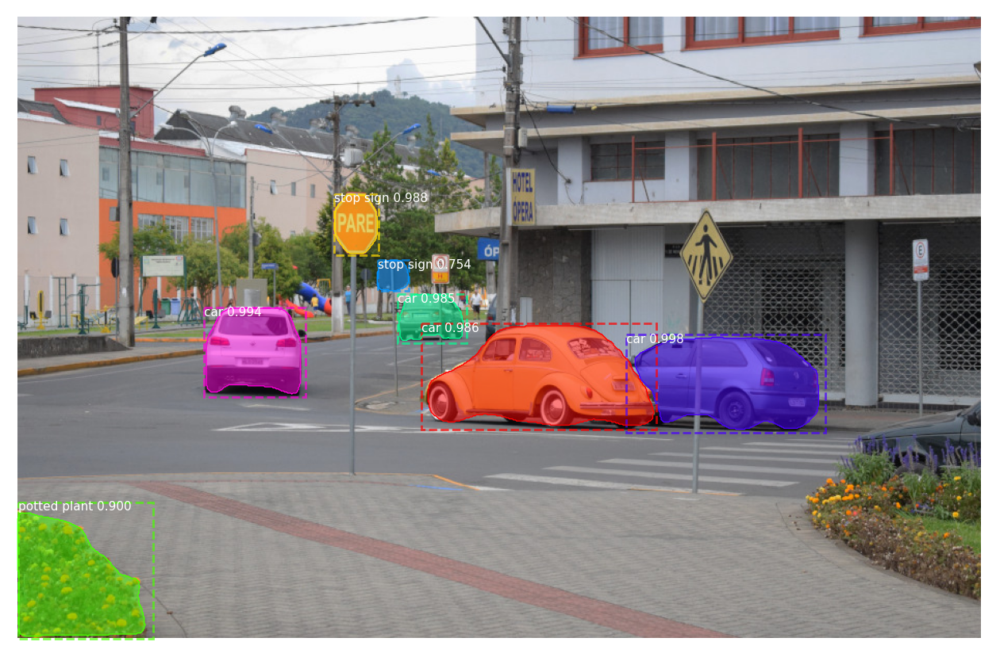

Segmentos detectados:  7


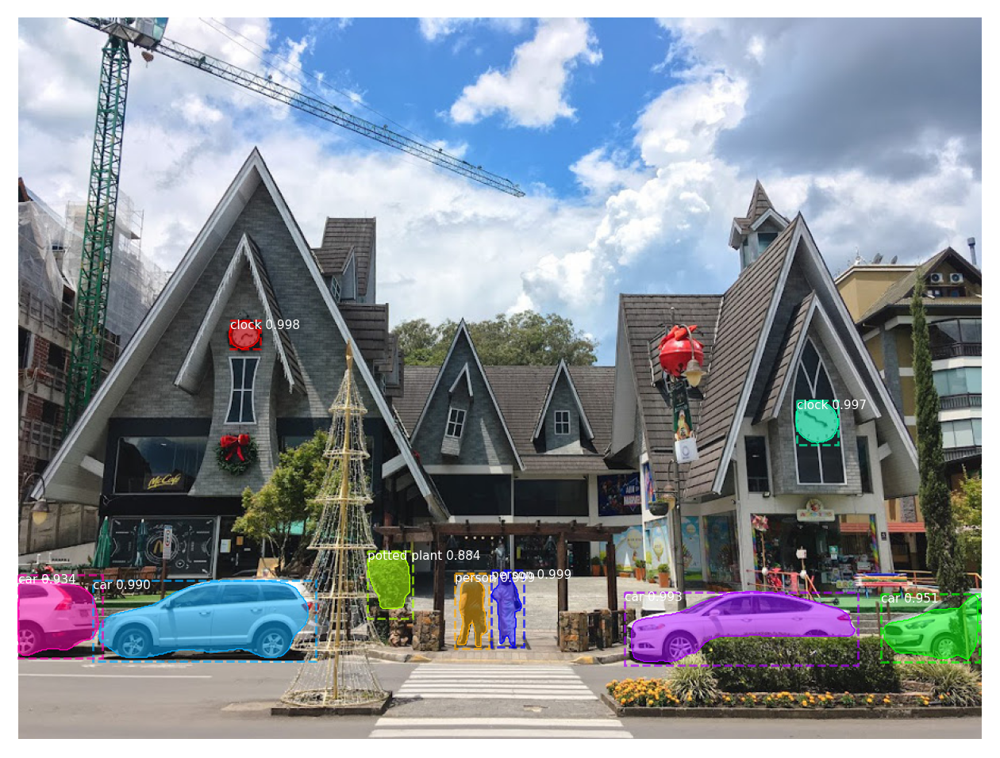

Segmentos detectados:  9


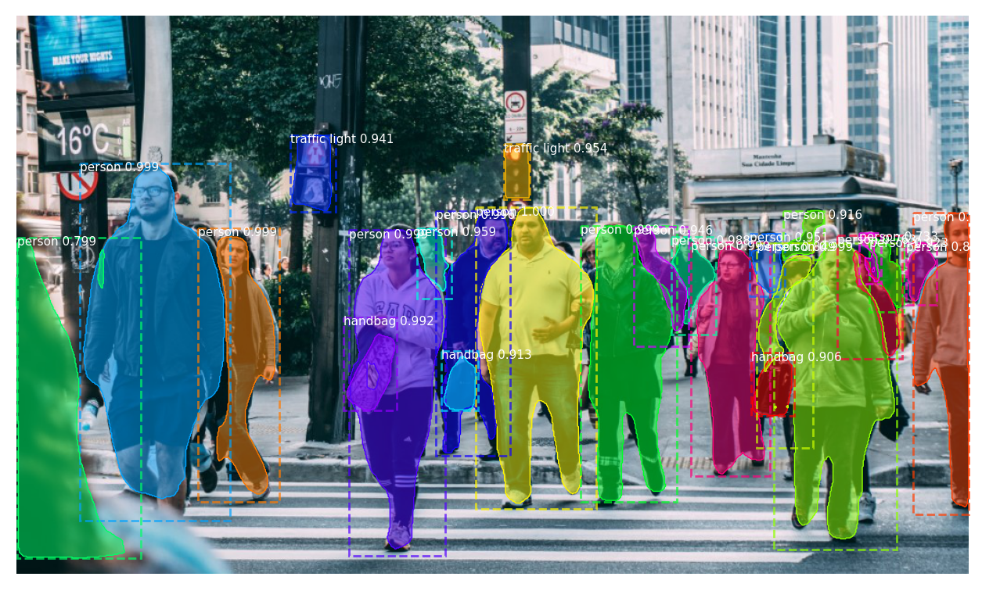

Segmentos detectados:  25


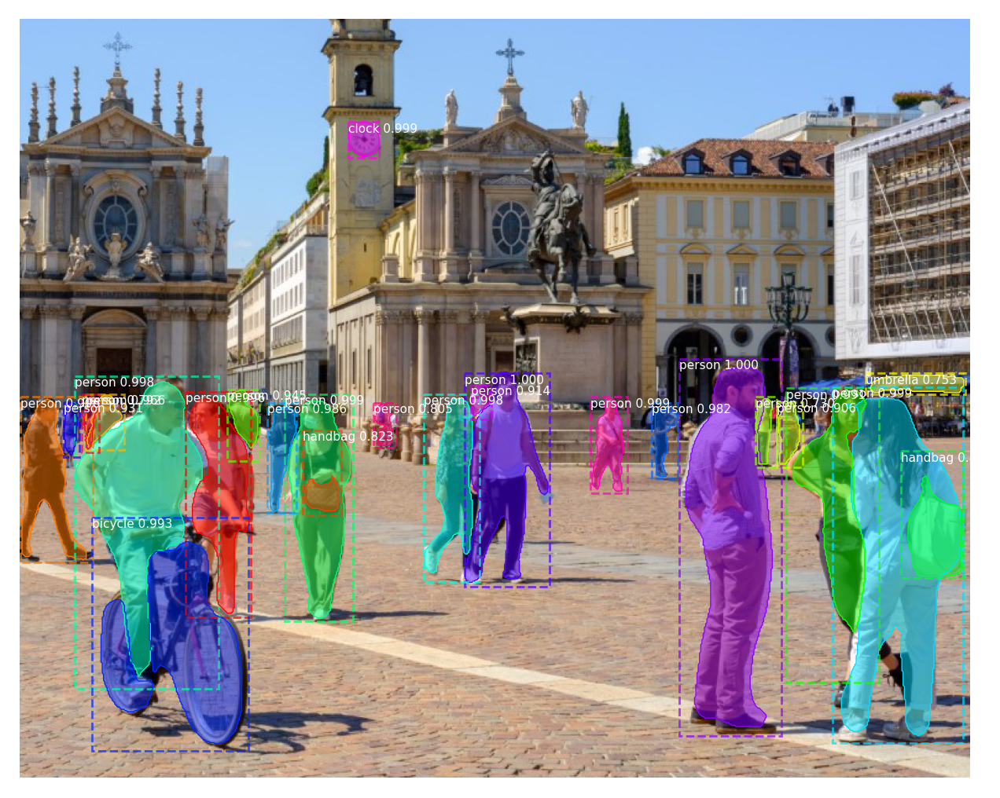

Segmentos detectados:  25


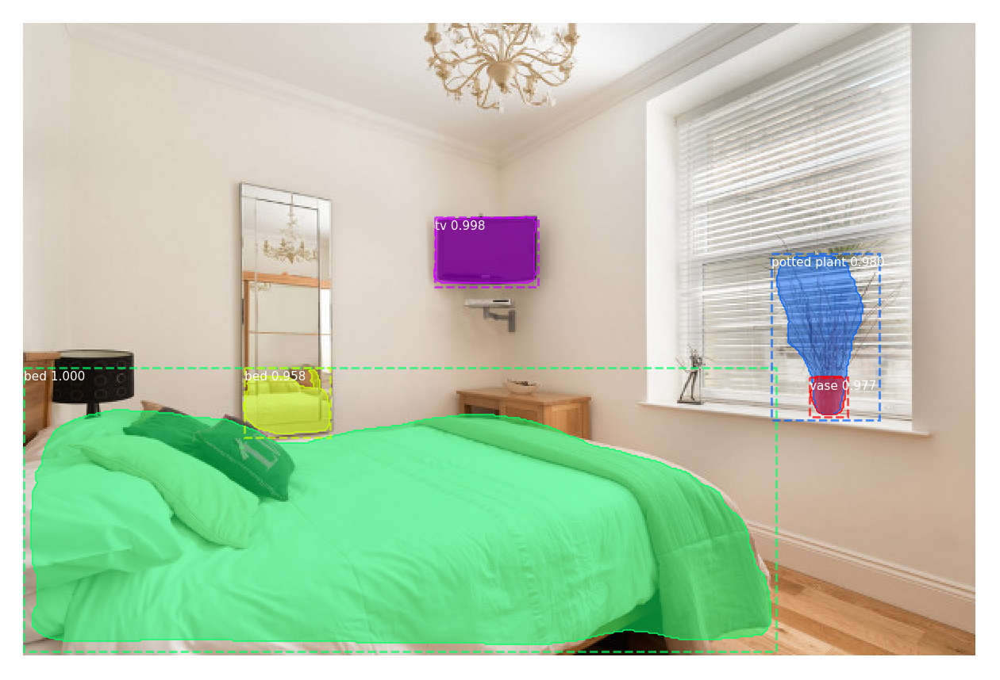

Segmentos detectados:  5


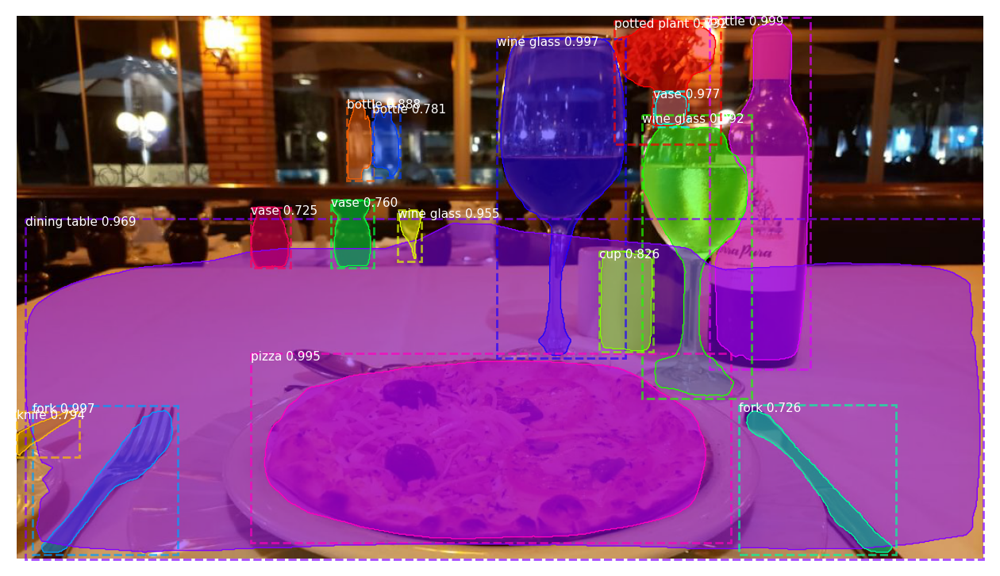

Segmentos detectados:  16


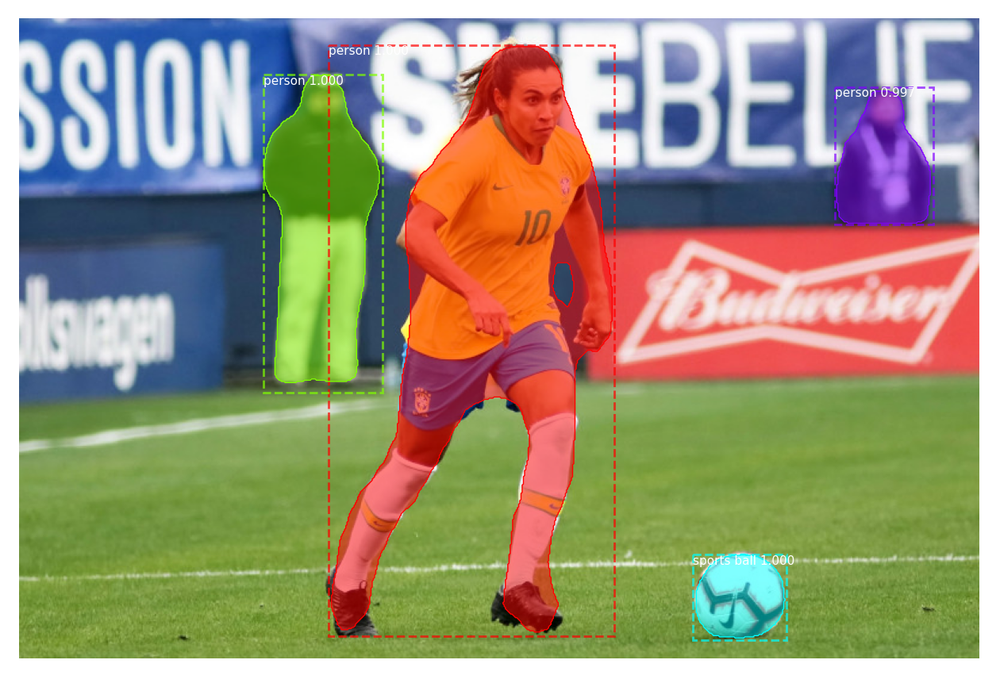

Segmentos detectados:  4


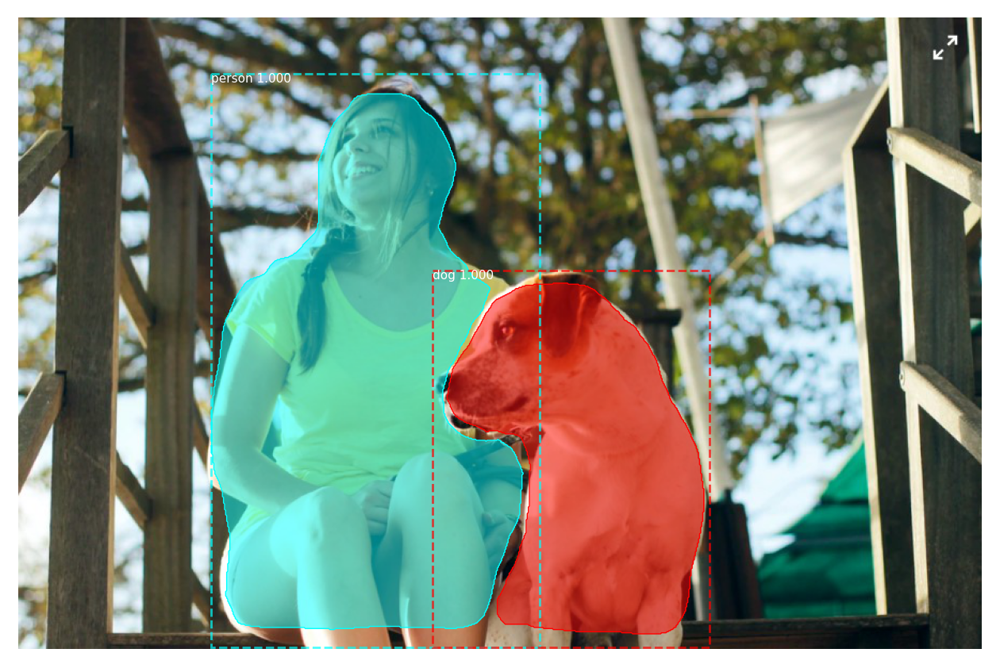

Segmentos detectados:  2


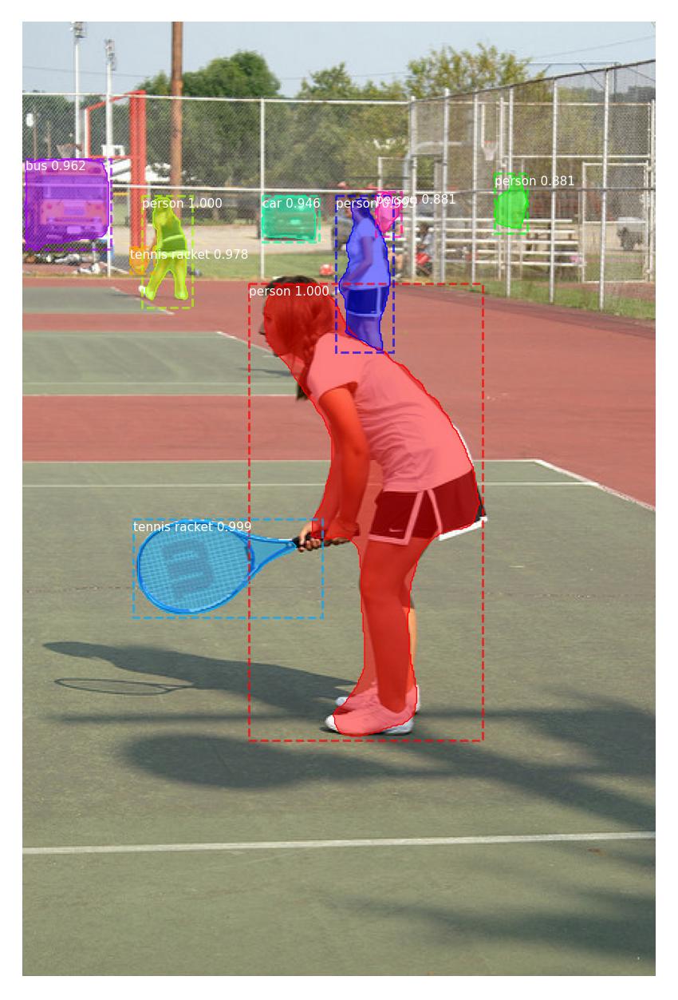

Segmentos detectados:  9


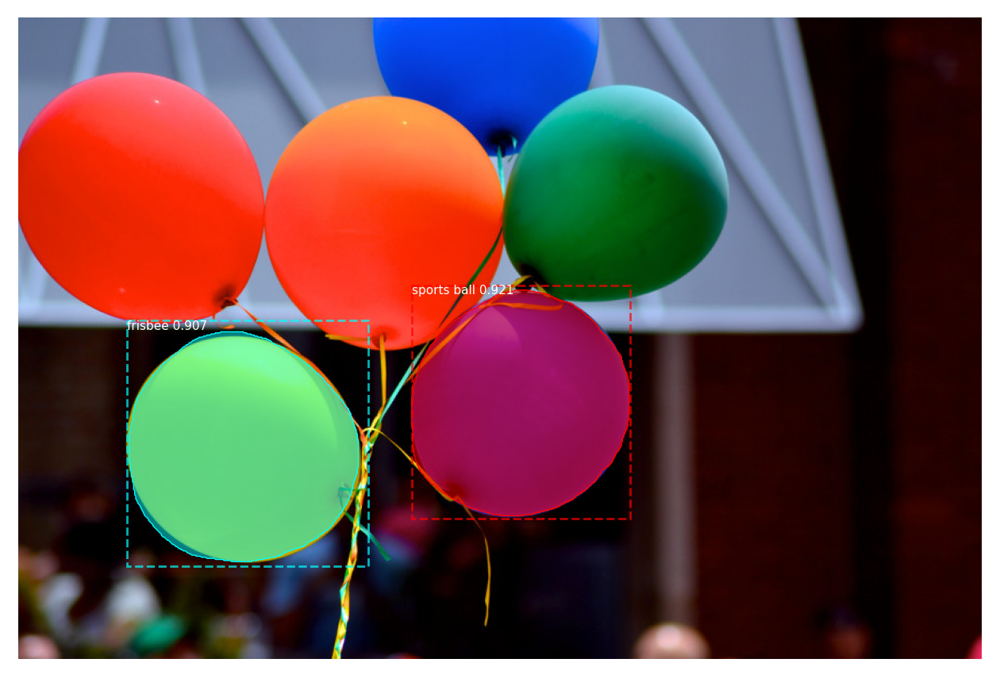

Segmentos detectados:  2


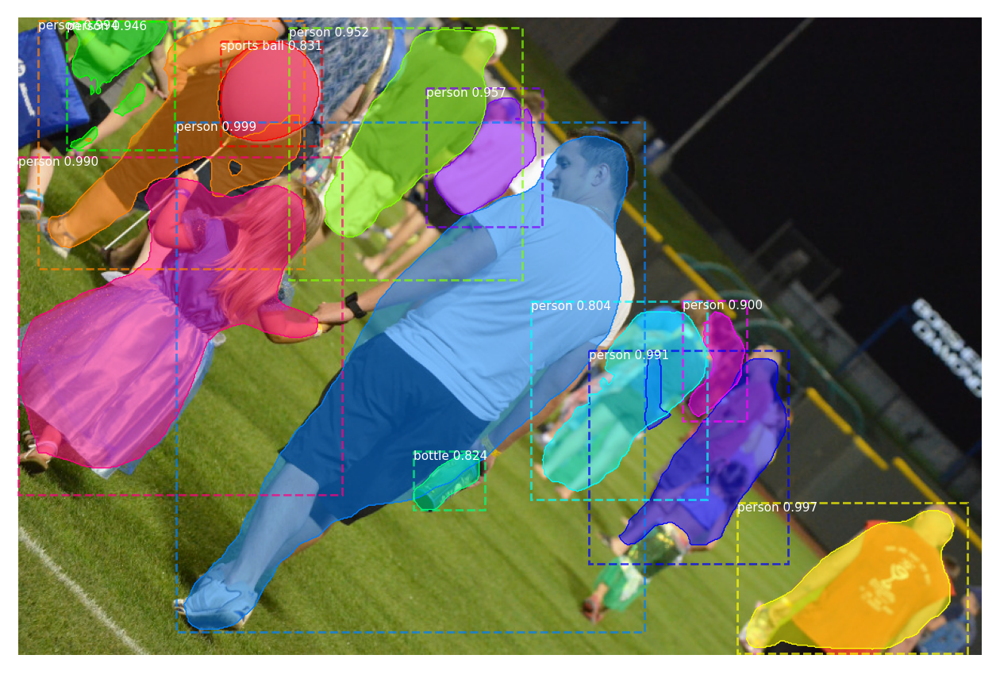

Segmentos detectados:  12


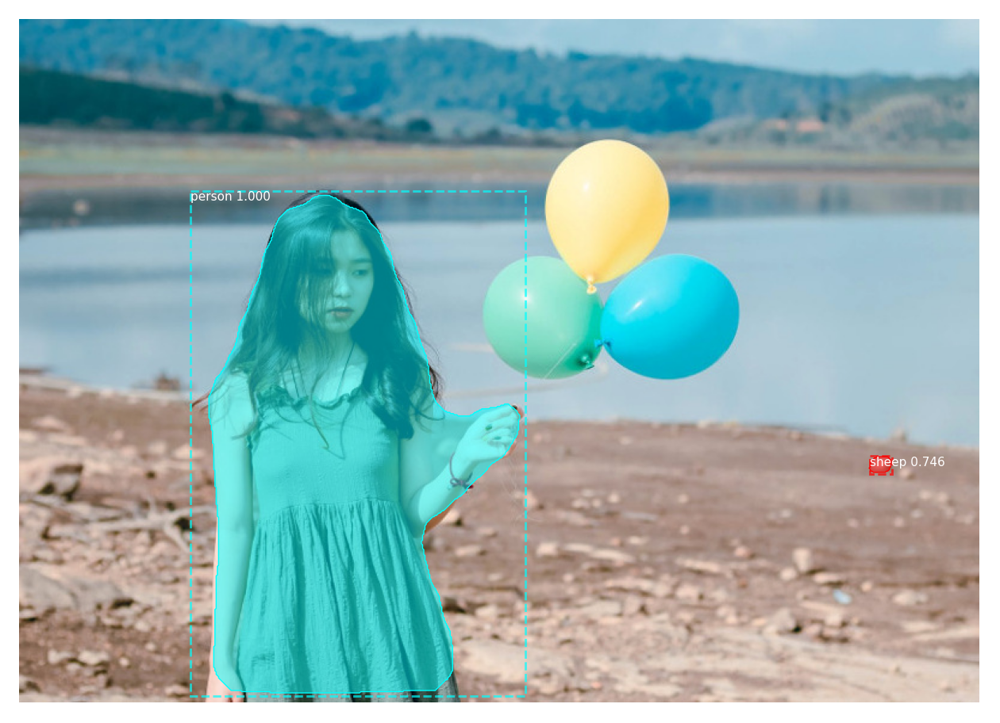

Segmentos detectados:  2


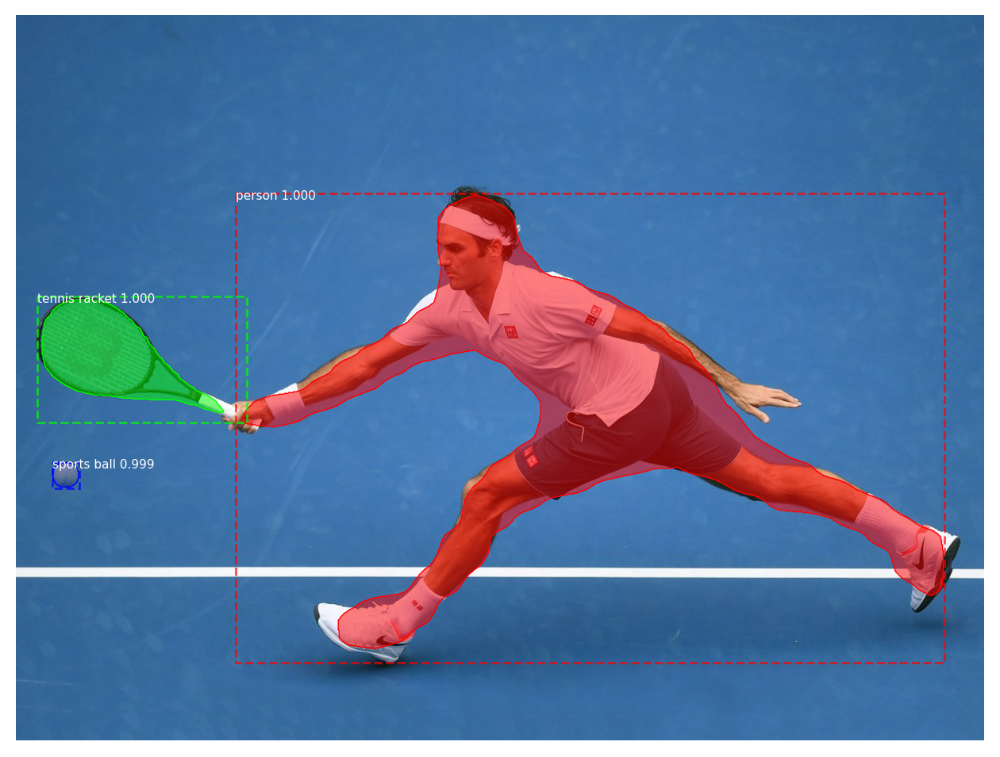

Segmentos detectados:  3


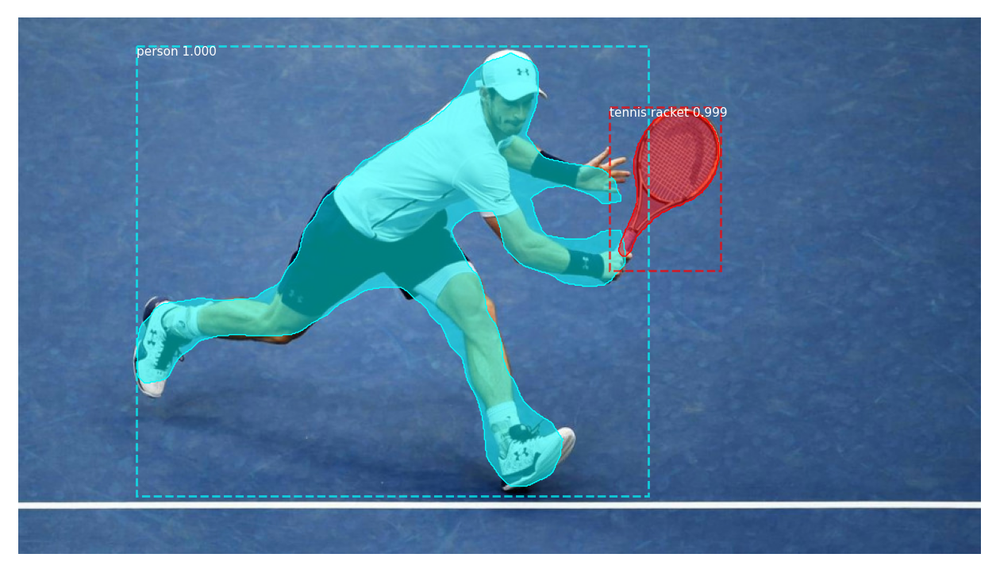

Segmentos detectados:  2


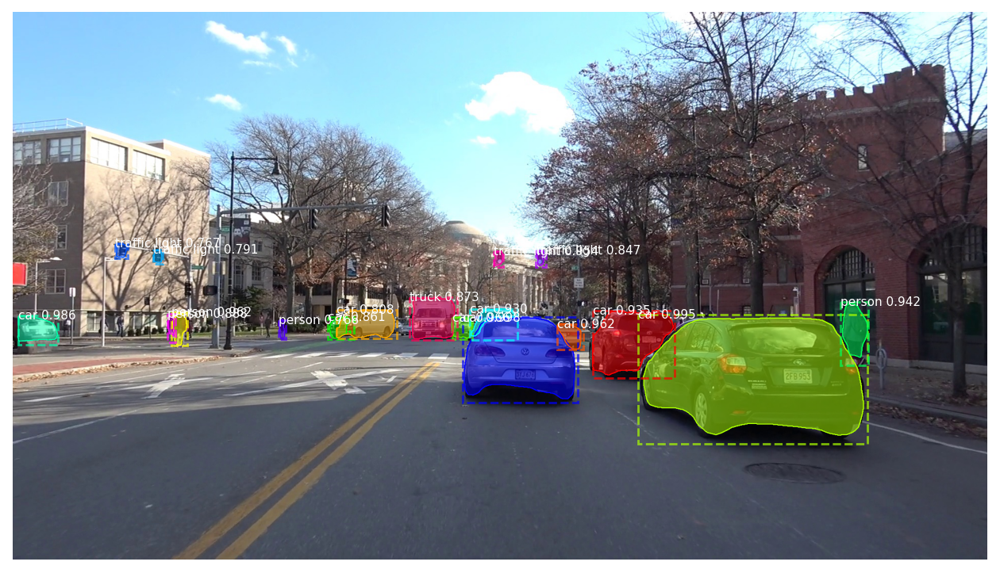

Segmentos detectados:  18


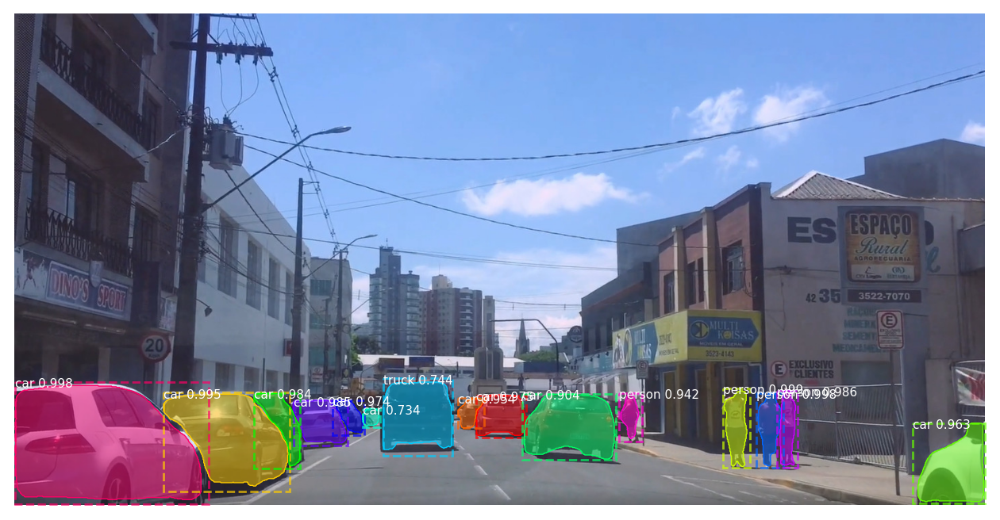

Segmentos detectados:  15


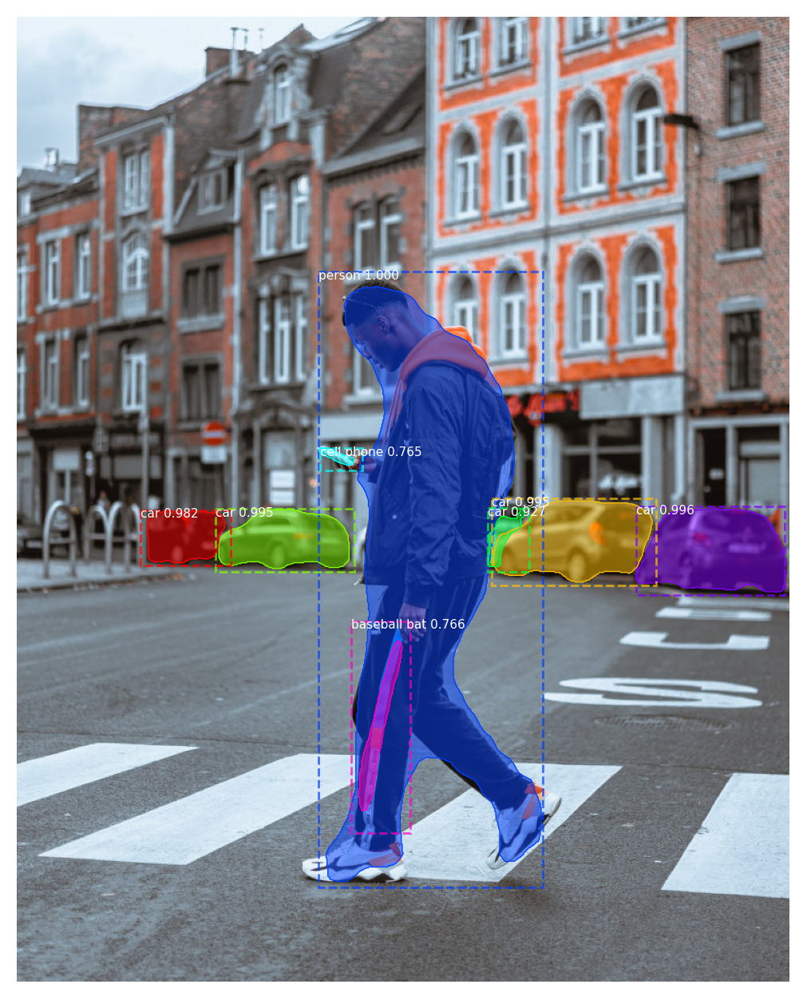

Segmentos detectados:  8


In [70]:
for caminho_img in caminhos:
  try:
    img = imread(caminho_img)
    (H, W) = img.shape[:2]
  except:
    continue
  segmentar_imagem(img)

# Contagem de Objetos

In [71]:
classe = 'car'
classe_id = class_names.index(classe)
classe_nome = class_names[classe_id]
print(classe_id, classe_nome)

3 car


In [73]:
total = 0
print('Classe: ', classe_nome)
for caminho_img in caminhos:
  img = imread(caminho_img)
  resultados = model.detect([img], verbose=0)
  r = resultados[0]
  numero = np.count_nonzero(r['class_ids'] == classe_id)
  total = total + numero
  print(str(caminho_img) + ' -> ' + classe_nome + ': ' + str(numero))

Classe:  car
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres01.jpg -> car: 7
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/motocross.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/elefante.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana02.jpg -> car: 16
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana01.jpg -> car: 4
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/cena-urbana03.jpg -> car: 4
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres03.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/pedestres02.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/quarto.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/jantar.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/futebol01.jpg -> car: 0
/content/drive/MyDrive/fotos-20230420T040945Z-001/fotos/garota-e-cachorro.jpg -> car: 0
/conten